In [1]:
"""
Inspect zbin 2 for bad spectra

Author: Alan Nguyen

22-06-2020
"""

'\nInspect zbin 2 for bad spectra\n\nAuthor: Alan Nguyen\n\n22-06-2020\n'

In [2]:
import numpy as np
import matplotlib
import matplotlib.pyplot as plt
from astropy.io import fits
from astropy.table import Table, Column
from scipy.optimize import curve_fit, leastsq
from astropy.cosmology import WMAP9 as cosmo
from astropy import units as u
import os
import math as m
from astropy import constants as const
import time
from BOSS_func_v9 import *
from general_functions_v1 import *

In [3]:
hdul = fits.open('AGN_zbin_fitsfiles\AGN_zbin2_v2.fits')

zbin2_data = hdul[1].data

hdul.close()

In [8]:
hdul = fits.open('AGN_results_files\zbin2_results_v2.fits')

zbin2_results = hdul[1].data

hdul.close()

In [18]:
flags = zbin2_results['FLAG']
select_outflows = (flags == 2) | (flags == 3)
select_nooutflows = (flags == 1) | (flags == 4)

In [19]:
zbin2_data_outflows = zbin2_data[select_outflows]
zbin2_data_nooutflows = zbin2_data[select_nooutflows]

In [20]:
specs ={}
count = 0

for row in zbin2_data_nooutflows:
    
    ######################################### set up file directories
    
    PLATE = str(row['PLATE'])
    MJD   = str(row['MJD'])
    FIBER = '{:04}'.format(row['FIBERID'])
    key_list = ['spec',PLATE, MJD, FIBER]
    key = '-'.join(key_list)
    filename = key + '.fits'
    folder = 'zbin2_specs'
    
    directory = os.path.join(folder, PLATE, filename)

    #########################################
    
    z = row['Z']
    k = 1 + z
    
    #########################################
    
    hdul = fits.open(directory) #using above directory open fits for the specific spectra
    data = hdul[1].data #again take only data not the header
    wave = 10 ** data['loglam'] #convert wavelength back to linear scale
    fluxden = data['flux'] #take fluxden
    inverse_variance = data['ivar'] #take inverse variance
    error = np.sqrt( 1 / inverse_variance ) #convert to standard deviation
    hdul.close()
    
    #########################################
    
    tempdat = [] #temporary list to hold each dataset before adding it to the dictionary
    
    #list indices to the right, called with spec-XXXX-XXXXX-XXXX, PLATE-MJD-FIBERID
    tempdat.append(wave)    #0 
    tempdat.append(fluxden) #1
    tempdat.append(k)       #2
    tempdat.append(error)   #3
    
    specs.update({key:tempdat})
    
    ###############################
    ###############################
    
    count += 1
    print("\r" + "Complete: {}/{}".format(count,len(zbin2_data_nooutflows)), end = "") #progress bar to keep track of progress

Complete: 30/191

C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:30: RuntimeWarning: divide by zero encountered in true_divide


Complete: 1089/191

In [21]:
#
#bring down the size of the dictionary to create a smaller working dictionary, trimmed just for the [OIII]5007 line
#

trimmed_specs = {}

count = 0 #for a loading bar lmao

bad_specs = []

for key in specs: #for every spectrum generated in previous block
    wave = specs[key][0] #extract wavelength array
    fluxden = specs[key][1] #extract flux density array
    k = specs[key][2] #z + 1, to account for redshift during the trimming
    error = specs[key][3] #extract flux density error array
    
    ###############################
    ###############################

    OIII_select = (wave > 4980*k) & (wave < 5030*k) #create parameter to trim the data for the [OIII]5007 line

    OIII_wave = wave[OIII_select] #select for [OIII]5007
    OIII_fluxden = fluxden[OIII_select] #select for [OIII]5007
    OIII_error = error[OIII_select] #select for [OIII]5007
    
    ###############################
    ###############################
    
    inf_indices = np.where(OIII_error == np.inf) #take indices where error is infinity for some reason?
    
    mean_error = np.mean(OIII_error[OIII_error != np.inf]) #take the mean error from the [OIII]5007 slice
    
    for i in inf_indices[0]: #replace all the infinity indices with the mean error
        OIII_error[i] = mean_error
    
    ###############################
    ###############################
    
    OIII_fluxden_scale = np.max(OIII_fluxden) #take the scale factor as the maximum flux density in this region
    
    OIII_norm_fluxden = OIII_fluxden / OIII_fluxden_scale #normalize so the peak is at one
    OIII_norm_error = OIII_error / OIII_fluxden_scale #scale the error to preserve relationship with flux density
    
    ###############################
    ###############################
    
    tempdat = [] #temporary list to hold each dataset before adding it to the dictionary
    
    #list indices to the right, called with spec-XXXX-XXXXX-XXXX, PLATE-MJD-FIBERID
    tempdat.append(OIII_wave)          #0 wavelength
    tempdat.append(OIII_norm_fluxden)  #1 normalized flux density
    tempdat.append(k)                  #2 k = z + 1
    tempdat.append(OIII_norm_error)    #3 normalized flux density error
    tempdat.append(OIII_fluxden_scale) #4 maximum flux density used to scale normalized flux density
    
    trimmed_specs.update({key:tempdat}) #update the trimmed dictionary with a smaller dataset
    
    ###############################
    ###############################
    
    if OIII_fluxden_scale == 0: #add to list of "flat" spectra
        bad_specs.append(key)
    
    ###############################
    ###############################
    
    count += 1
    print("\r" + "Complete: {}/{}".format(count,len(specs)), end = "") #progress bar to keep track of progress
    
    ###############################
    ###############################
    
for s in bad_specs: #remove bad spectra from the trimmed dictionary
    trimmed_specs.pop(key, None)

Complete: 533/1089

Complete: 1089/1089

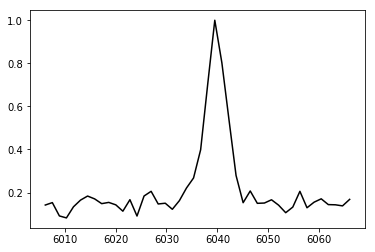

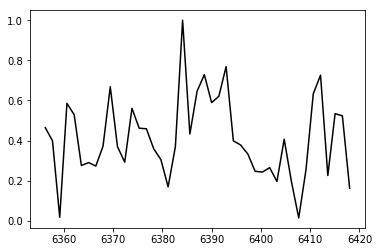

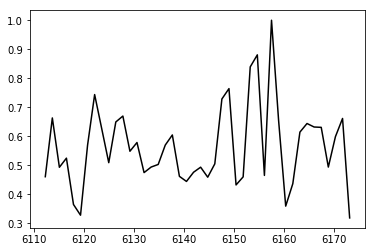

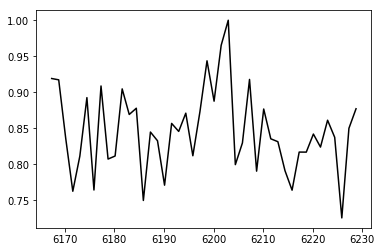

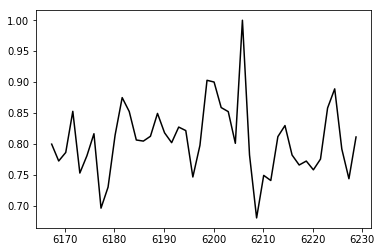

...

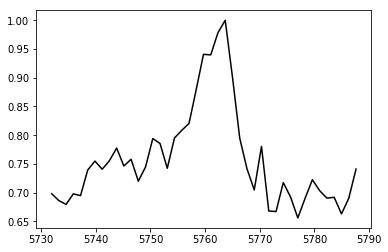

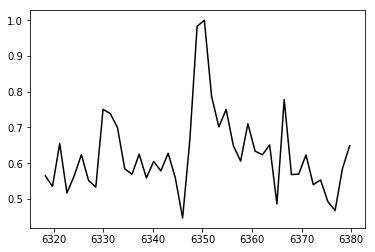

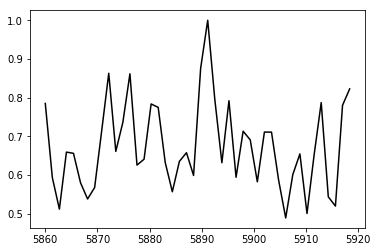

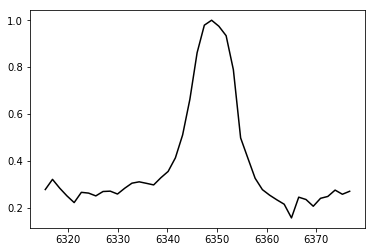

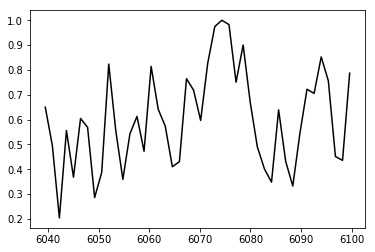

<Figure size 432x288 with 0 Axes>

In [22]:
for key in trimmed_specs:
    
    OIII_wave    = trimmed_specs[key][0] #array with wavelength values for the current spectrum in angstrom
    OIII_fluxden = trimmed_specs[key][1] #array with corresponding flux density values
    k            = trimmed_specs[key][2] #corresponding z + 1 value
    OIII_error   = trimmed_specs[key][3] #array with corresponding flux density error values
    
    plt.plot(OIII_wave, OIII_fluxden, 'k-')
    plt.show()
    plt.clf()

In [24]:
zbin2_data.columns

ColDefs(
    name = 'PLATE'; format = 'J'
    name = 'MJD'; format = 'J'
    name = 'FIBERID'; format = 'J'
    name = 'RA'; format = 'D'
    name = 'DEC'; format = 'D'
    name = 'Z'; format = 'E'
    name = 'Z_ERR'; format = 'E'
    name = 'ZNUM'; format = 'J'
    name = 'VEL_STARS'; format = 'E'
    name = 'REDSHIFT'; format = 'E'
    name = 'SIGMA_STARS'; format = 'E'
    name = 'SIGMA_STARS_ERR'; format = 'E'
    name = 'CHISQ'; format = 'E'
    name = 'FILENAME'; format = '30A'
    name = 'BPT'; format = '13A'
    name = 'NAME'; format = '3136A'; dim = '(112,28)'
    name = 'LAMBDA'; format = '28E'
    name = 'KIND'; format = '1344A'; dim = '(48,28)'
    name = 'A'; format = '28E'
    name = 'V'; format = '28E'
    name = 'V_ERR'; format = '28E'
    name = 'SIG'; format = '28E'
    name = 'SIG_ERR'; format = '28E'
    name = 'AMPLITUDE'; format = '28E'
    name = 'AMPLITUDE_ERR'; format = '28E'
    name = 'FLUX'; format = '28E'
    name = 'FLUX_ERR'; format = '28E'
    name = 'EW